In [ ]:
import pandas as pd
import pickle

# Converting training data to .pkl form

# Creates file path for the training annotations .csv file
csv_file_path = "train/_annotations.csv"

# Variable for training data frame
df = pd.read_csv(csv_file_path)

# Empty array for proccessed data
processed_data = []

# Pulls all necessarry data from training annotations (image name, bounding box specs, class within image)
# Places this data into the processed_data array
for _, row in df.iterrows():
    data = {
        'image_path': row['filename'],
        'bbox': [row['xmin'], row['ymin'], row['xmax'], row['ymax']],
        'category': row['class'],
    }
    processed_data.append(data)

# Creates a name for the training data pickle file
pkl_file_path = "thermal_train.pkl"

# Places all processed_data from annoations file into a pickle file with the name from previous line
with open(pkl_file_path, 'wb') as f:
    pickle.dump(processed_data, f)


In [ ]:
# Converting testing data to .pkl form

# Creates file path for the testing annotations .csv file
csv_file_path = "test/_annotations.csv"

# Variable for testing data frame
df = pd.read_csv(csv_file_path)

# Empty array for proccessed data
processed_data = []

# Pulls all necessarry data from testing annotations (image name, bounding box specs, class within image)
# Places this data into the processed_data array
for _, row in df.iterrows():
    data = {
        'image_path': row['filename'],
        'bbox': [row['xmin'], row['ymin'], row['xmax'], row['ymax']],
        'category': row['class'],
    }
    processed_data.append(data)

# Creates a name for the testing data pickle file
pkl_file_path = "thermal_test.pkl"

# Places all processed_data from annoations file into a pickle file with the name from previous line
with open(pkl_file_path, 'wb') as f:
    pickle.dump(processed_data, f)


In [ ]:
# Converting validation data to .pkl form

# Creates file path for the validation annotations .csv file
csv_file_path = "valid/_annotations.csv"

# Variable for validation data frame
df = pd.read_csv(csv_file_path)

# Empty array for proccessed data
processed_data = []

# Pulls all necessarry data from validation annotations (image name, bounding box specs, class within image)
# Places this data into the processed_data array
for _, row in df.iterrows():
    data = {
        'image_path': row['filename'],
        'bbox': [row['xmin'], row['ymin'], row['xmax'], row['ymax']],
        'category': row['class'],
    }
    processed_data.append(data)

# Creates a name for the validation data pickle file
pkl_file_path = "thermal_valid.pkl"

# Places all processed_data from annoations file into a pickle file with the name from previous line
with open(pkl_file_path, 'wb') as f:
    pickle.dump(processed_data, f)


In [ ]:
import os
import shutil
import cv2
from pathlib import Path

# loads training data from created pickle file
with open('thermal_train.pkl', 'rb') as f:
    training_data = pickle.load(f)

# new folders created to store training images and labels for yolo interpretation
image_train_dir = "yolov5_data/images/train"
label_train_dir = "yolov5_data/labels/train"

training_folder = "train"

Path(image_train_dir).mkdir(parents = True, exist_ok = True)
Path(label_train_dir).mkdir(parents = True, exist_ok = True)

class_map = {"person": 0, "dog" : 1}

# process each entry in training data
for entry in training_data:
    image_path = entry["image_path"]
    bbox = entry['bbox']
    category = entry['category']

    image_path = Path(training_folder) / image_path
    file_name = entry["image_path"]

    # copy image into target folder
    shutil.copy(image_path, image_train_dir)

    if file_name.endswith(('.jpg', '.jpeg', '.png')):
        base_name = os.path.splitext(file_name)[0]
        label_file = os.path.join(label_train_dir, base_name + '.txt')
        with open(label_file, 'w') as f:
            
            # convert bbox to yolo format
            x_min, y_min, x_max, y_max = bbox
            width, height = x_max - x_min, y_max - y_min
            x_center = (x_min + x_max)/2
            y_center = (y_min + y_max)/2

            # normalize to get image dimensions
            image = cv2.imread(image_path)
            img_width, img_height = image.shape[1], image.shape[0]
            x_center /= img_width
            y_center /= img_height
            width /= img_width
            height /= img_height

            # write label in yolo format: class_id, x_center, y_center, width, height
            f.write(f"{class_map[category]} {x_center} {y_center} {width} {height}\n")


In [ ]:
import os
import shutil
import cv2
from pathlib import Path

# loads testing data from created pickle file
with open('thermal_test.pkl', 'rb') as f:
    testing_data = pickle.load(f)

# new folders created to store testing images and labels for yolo interpretation
image_test_dir = "yolov5_data/images/test"
label_test_dir = "yolov5_data/labels/test"

testing_folder = "test"

Path(image_test_dir).mkdir(parents = True, exist_ok = True)
Path(label_test_dir).mkdir(parents = True, exist_ok = True)

class_map = {"person": 0, "dog" : 1}

# process each entry in testing data
for entry in testing_data:
    image_path = entry["image_path"]
    bbox = entry['bbox']
    category = entry['category']

    image_path = Path(testing_folder) / image_path
    file_name = entry["image_path"]

    # copy image into target folder
    shutil.copy(image_path, image_test_dir)

    if file_name.endswith(('.jpg', '.jpeg', '.png')):
        base_name = os.path.splitext(file_name)[0]
        label_file = os.path.join(label_test_dir, base_name + '.txt')
        with open(label_file, 'w') as f:
            
            # convert bbox to yolo format
            x_min, y_min, x_max, y_max = bbox
            width, height = x_max - x_min, y_max - y_min
            x_center = (x_min + x_max)/2
            y_center = (y_min + y_max)/2

            # normalize to get image dimensions
            image = cv2.imread(image_path)
            img_width, img_height = image.shape[1], image.shape[0]
            x_center /= img_width
            y_center /= img_height
            width /= img_width
            height /= img_height

            # write label in yolo format: class_id, x_center, y_center, width, height
            f.write(f"{class_map[category]} {x_center} {y_center} {width} {height}\n")

In [ ]:
import os
import shutil
import cv2
from pathlib import Path

# loads validation data from created pickle file
with open('thermal_valid.pkl', 'rb') as f:
    valid_data = pickle.load(f)

# new folders created to store validation images and labels for yolo interpretation
image_valid_dir = "yolov5_data/images/val"
label_valid_dir = "yolov5_data/labels/val"

valid_folder = "valid"

Path(image_valid_dir).mkdir(parents = True, exist_ok = True)
Path(label_valid_dir).mkdir(parents = True, exist_ok = True)

class_map = {"person": 0, "dog" : 1}

# process each entry in validation data
for entry in valid_data:
    image_path = entry["image_path"]
    bbox = entry['bbox']
    category = entry['category']

    image_path = Path(valid_folder) / image_path
    file_name = entry["image_path"]

    # copy image into target folder
    shutil.copy(image_path, image_valid_dir)

    if file_name.endswith(('.jpg', '.jpeg', '.png')):
        base_name = os.path.splitext(file_name)[0]
        label_file = os.path.join(label_valid_dir, base_name + '.txt')
        with open(label_file, 'w') as f:
            
            # convert bbox to yolo format
            x_min, y_min, x_max, y_max = bbox
            width, height = x_max - x_min, y_max - y_min
            x_center = (x_min + x_max)/2
            y_center = (y_min + y_max)/2

            # normalize to get image dimensions
            image = cv2.imread(image_path)
            img_width, img_height = image.shape[1], image.shape[0]
            x_center /= img_width
            y_center /= img_height
            width /= img_width
            height /= img_height

            # write label in yolo format: class_id, x_center, y_center, width, height
            f.write(f"{class_map[category]} {x_center} {y_center} {width} {height}\n")

Using cache found in C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2024-11-24 Python-3.9.6 torch-2.5.1+cpu CPU

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


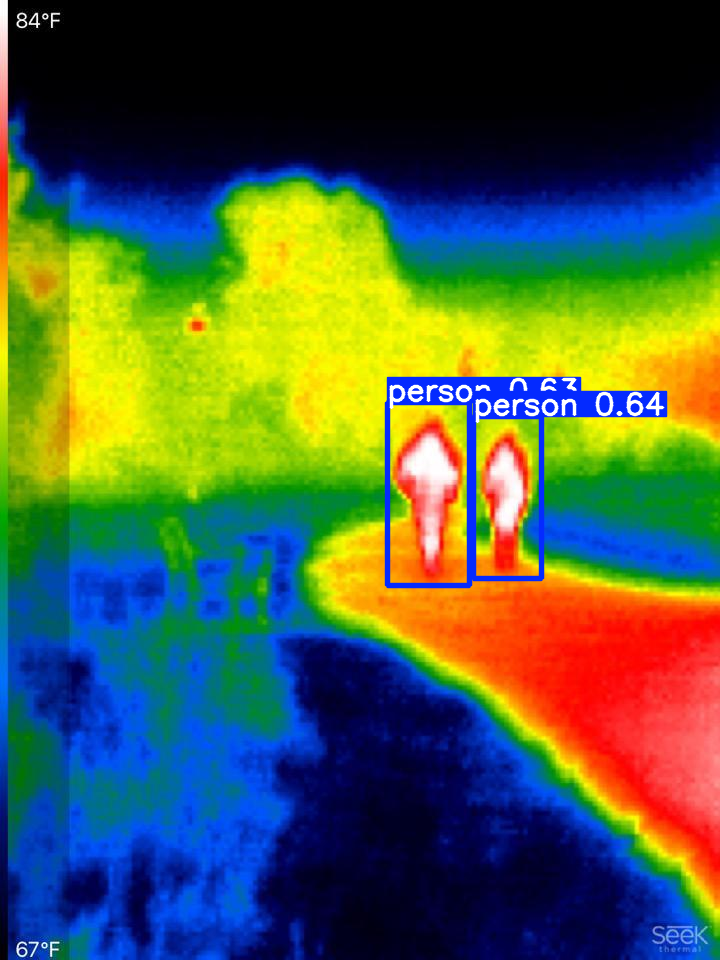

Saved 1 image to runs\detect\exp221
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


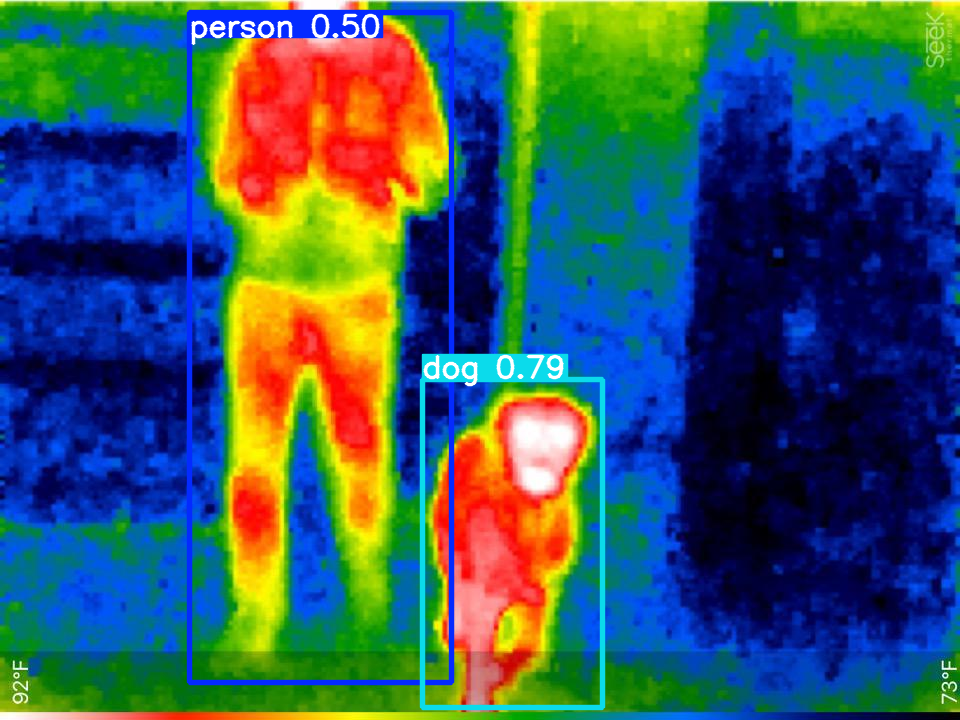

Saved 1 image to runs\detect\exp222
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


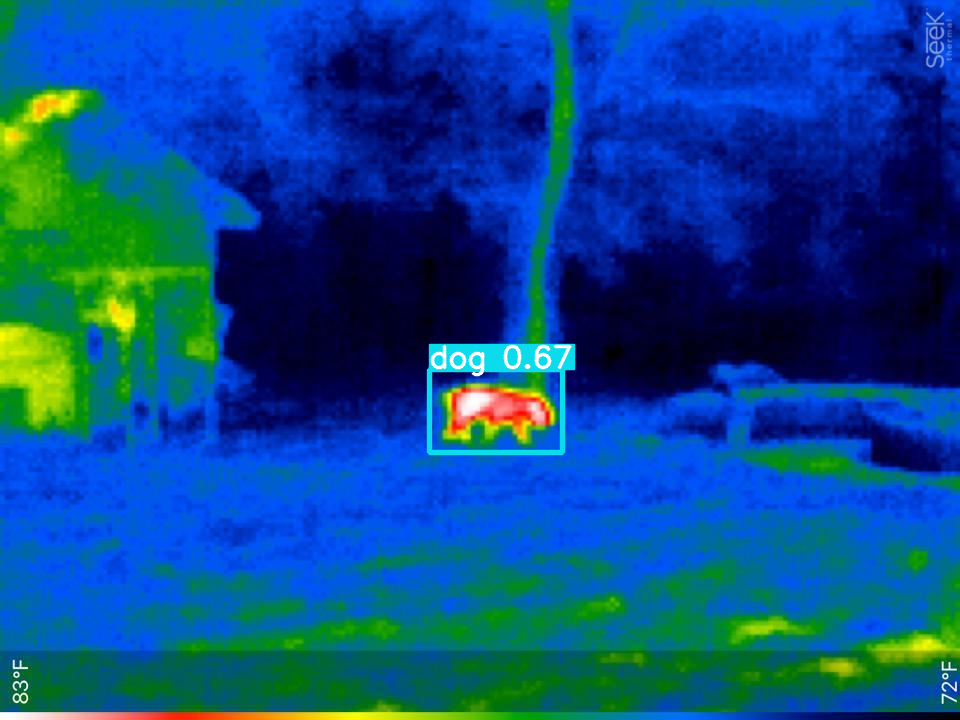

Saved 1 image to runs\detect\exp223
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


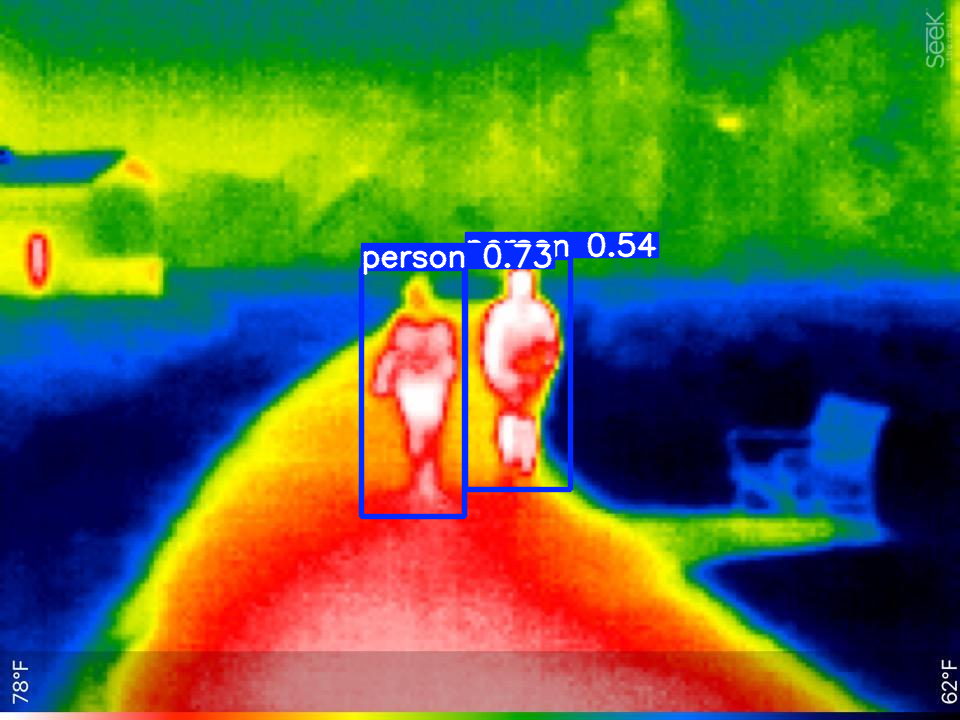

Saved 1 image to runs\detect\exp224
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


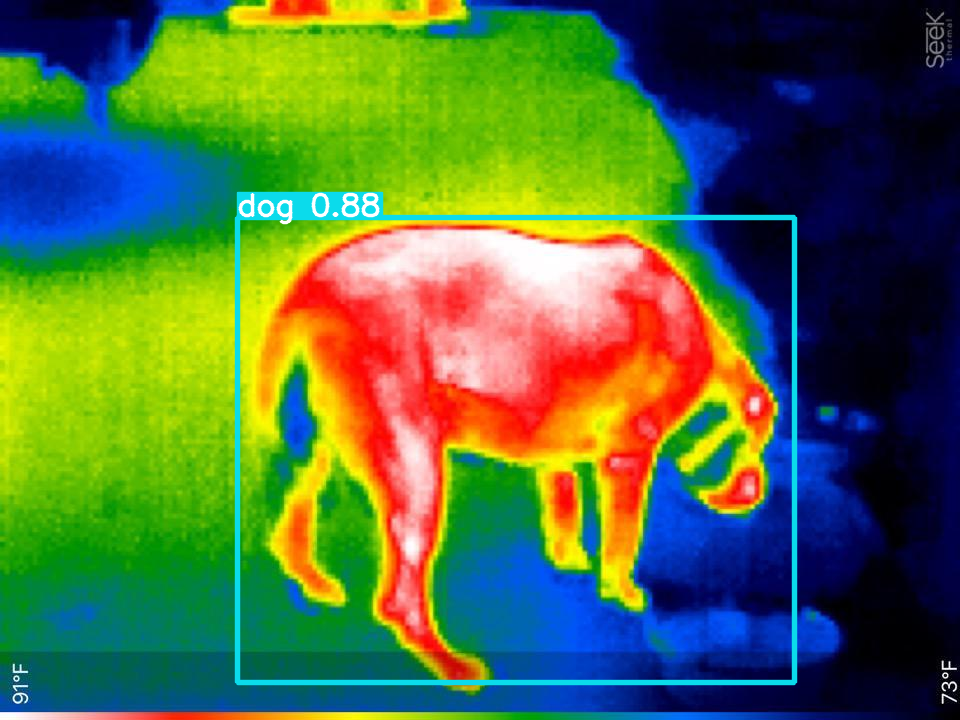

Saved 1 image to runs\detect\exp225
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


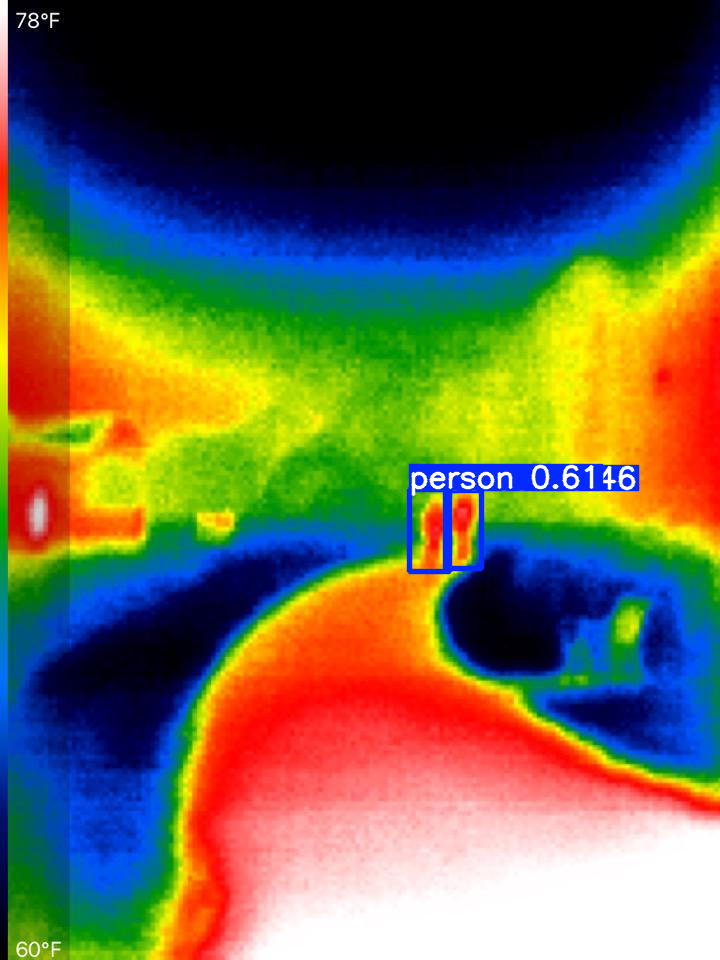

Saved 1 image to runs\detect\exp226
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


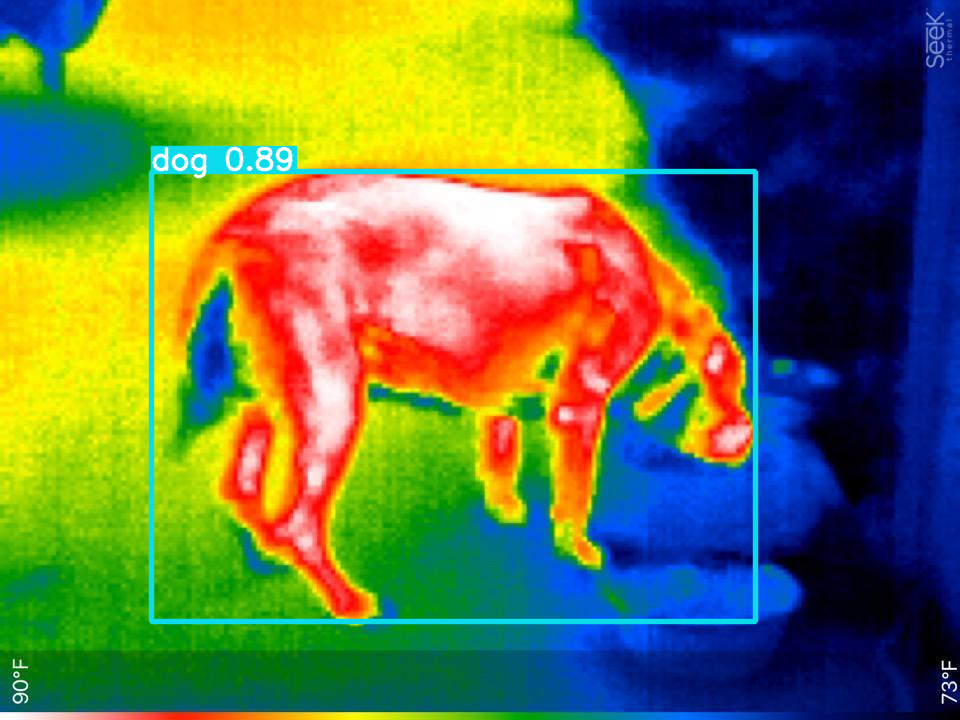

Saved 1 image to runs\detect\exp227
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


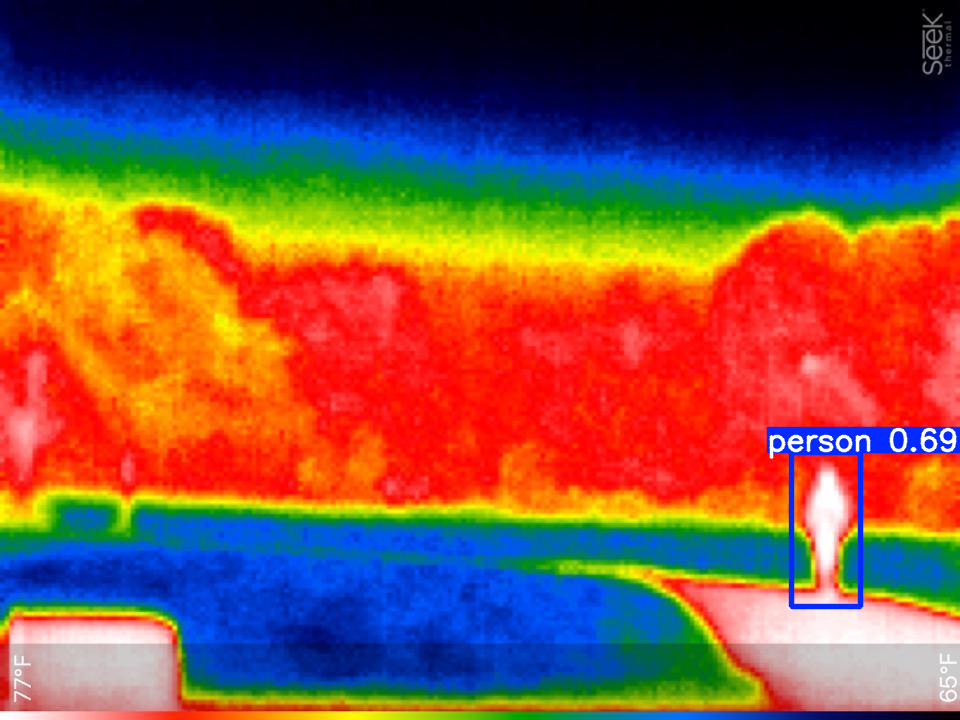

Saved 1 image to runs\detect\exp228
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


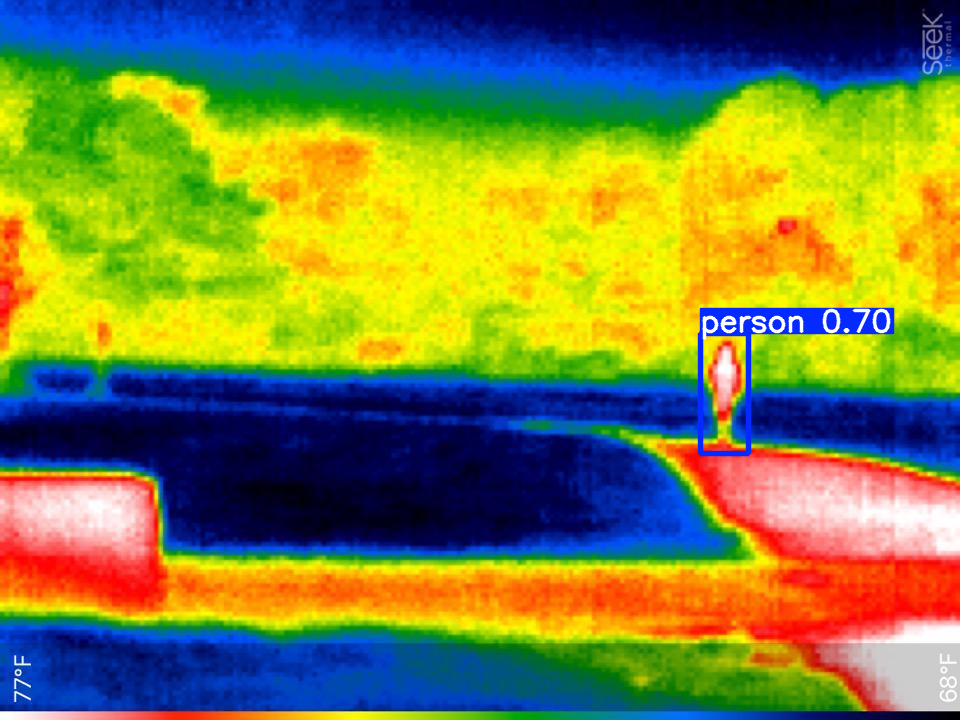

Saved 1 image to runs\detect\exp229
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


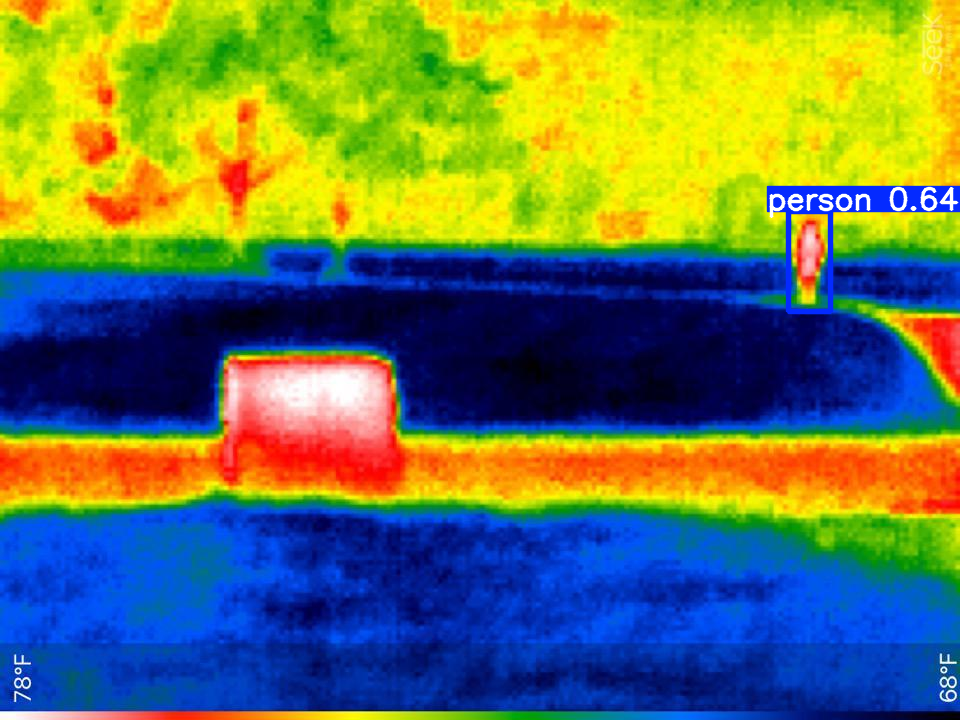

Saved 1 image to runs\detect\exp230
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


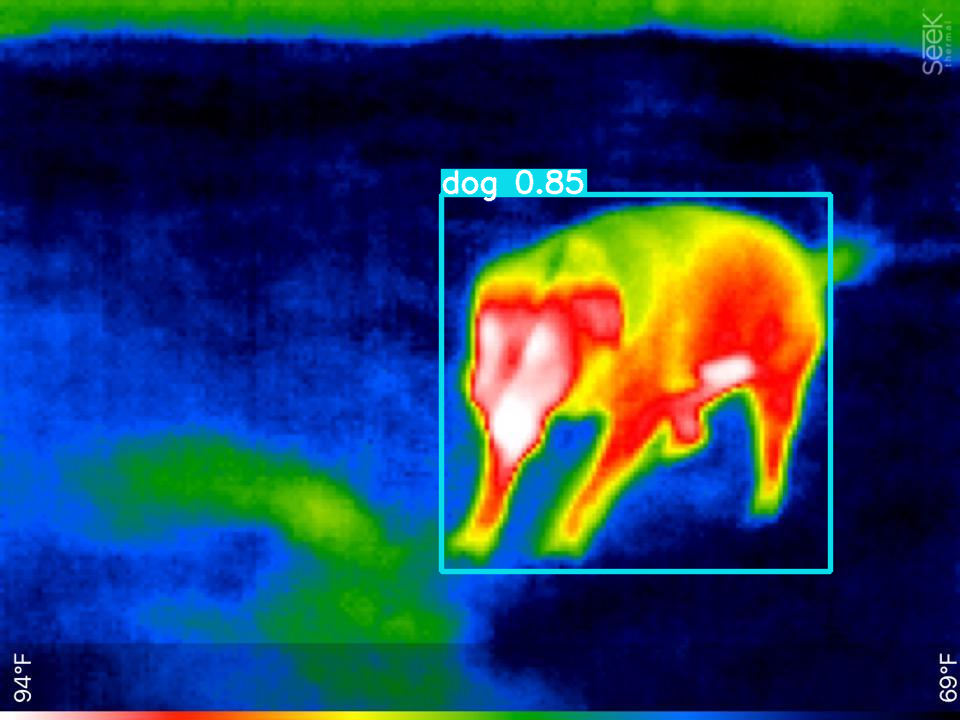

Saved 1 image to runs\detect\exp231
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


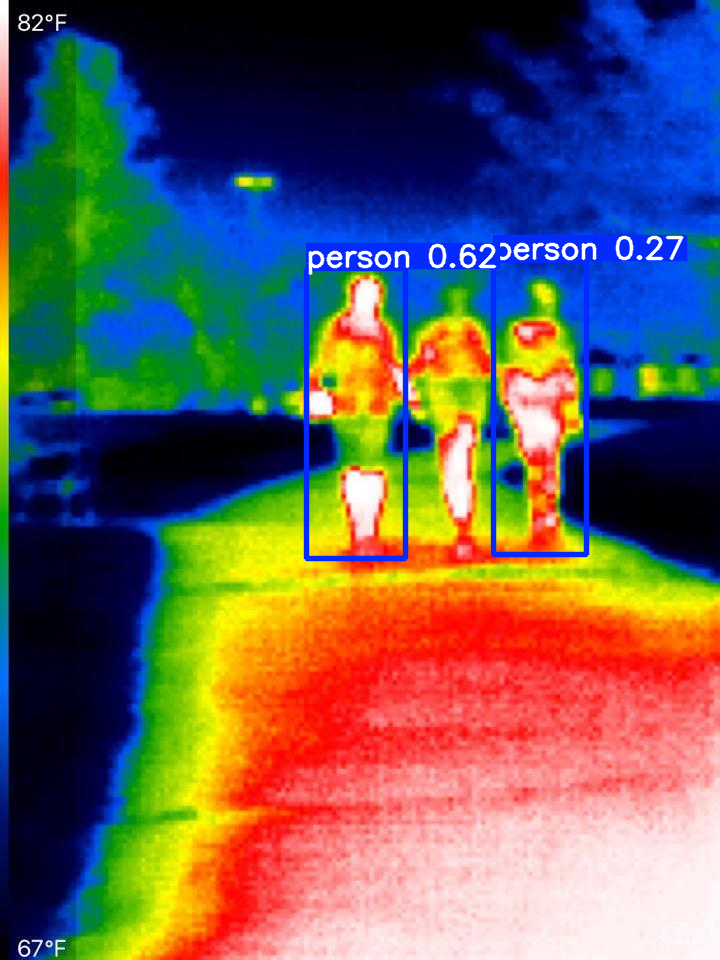

Saved 1 image to runs\detect\exp232
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


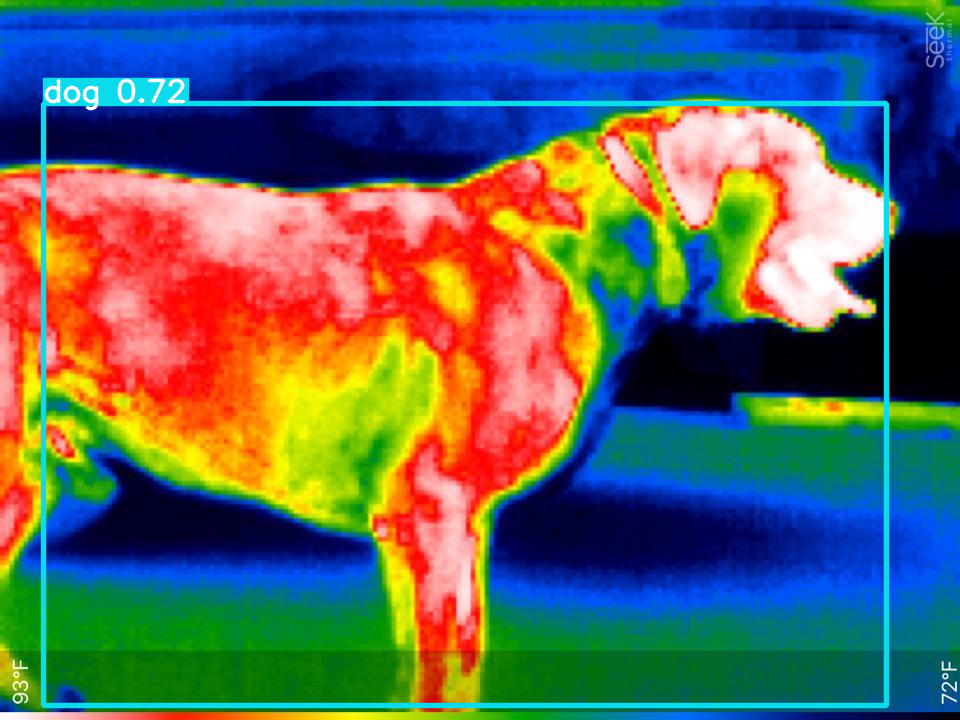

Saved 1 image to runs\detect\exp233
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


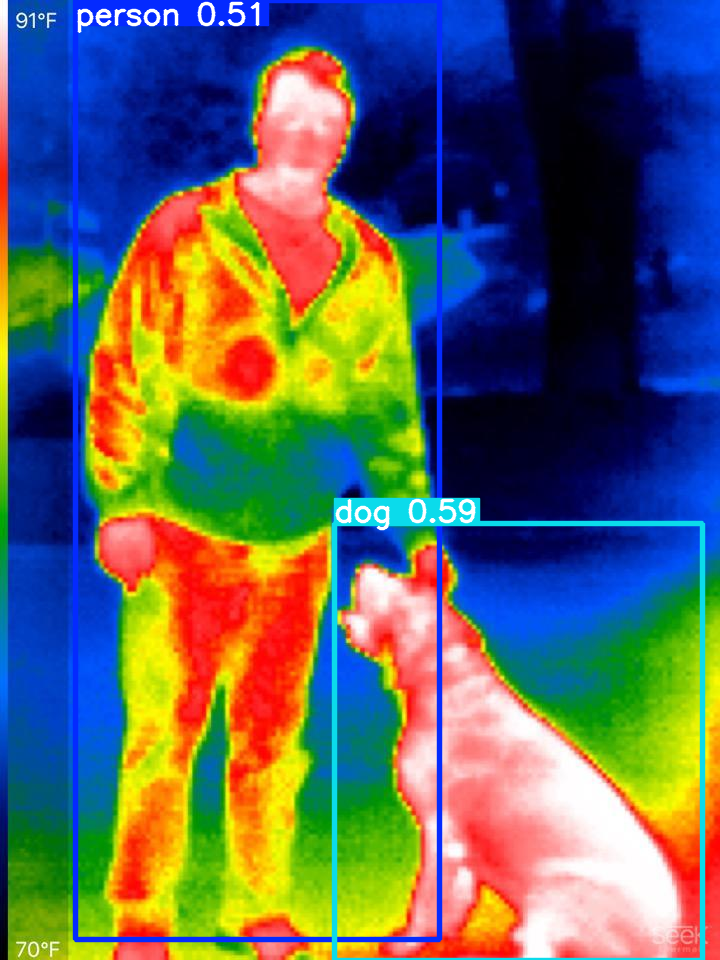

Saved 1 image to runs\detect\exp234
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


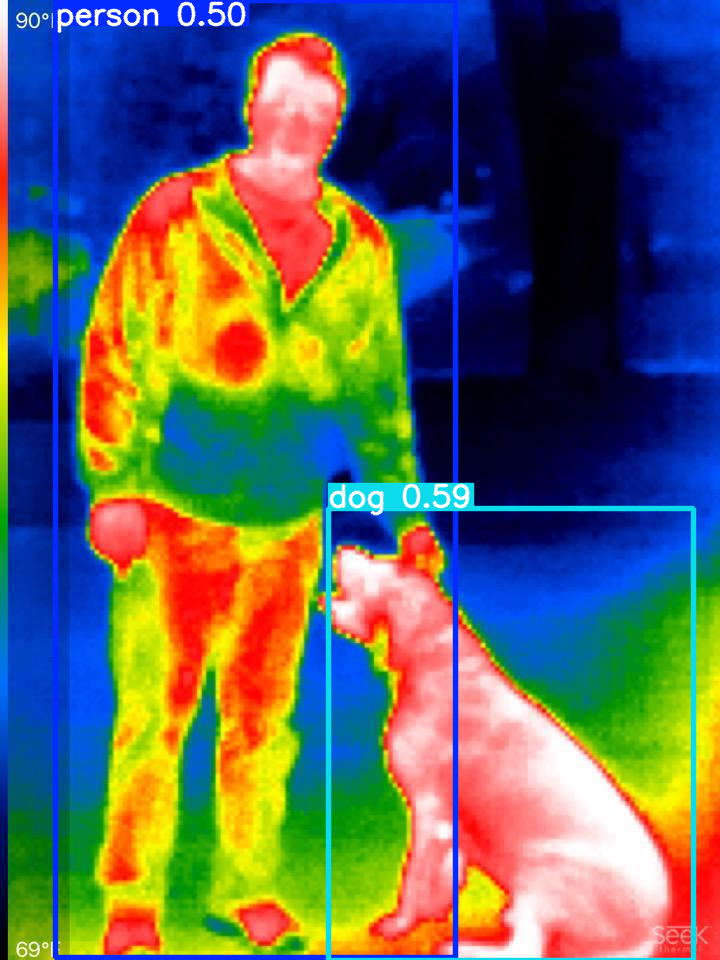

Saved 1 image to runs\detect\exp235
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


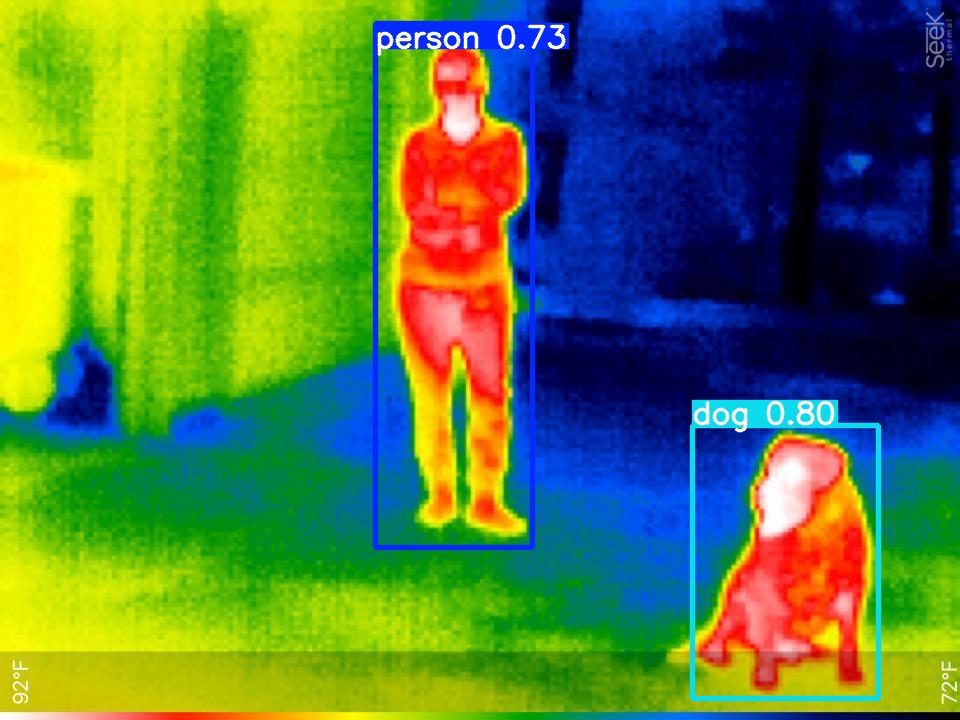

Saved 1 image to runs\detect\exp236
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


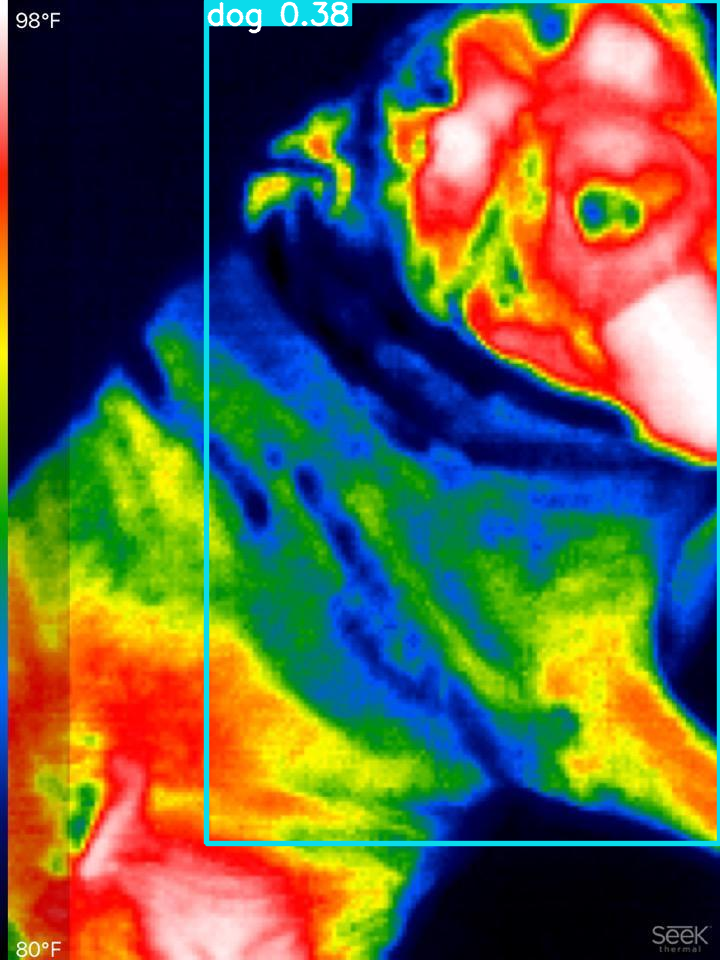

Saved 1 image to runs\detect\exp237
C:\Users\C25Andrew.Durkin/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


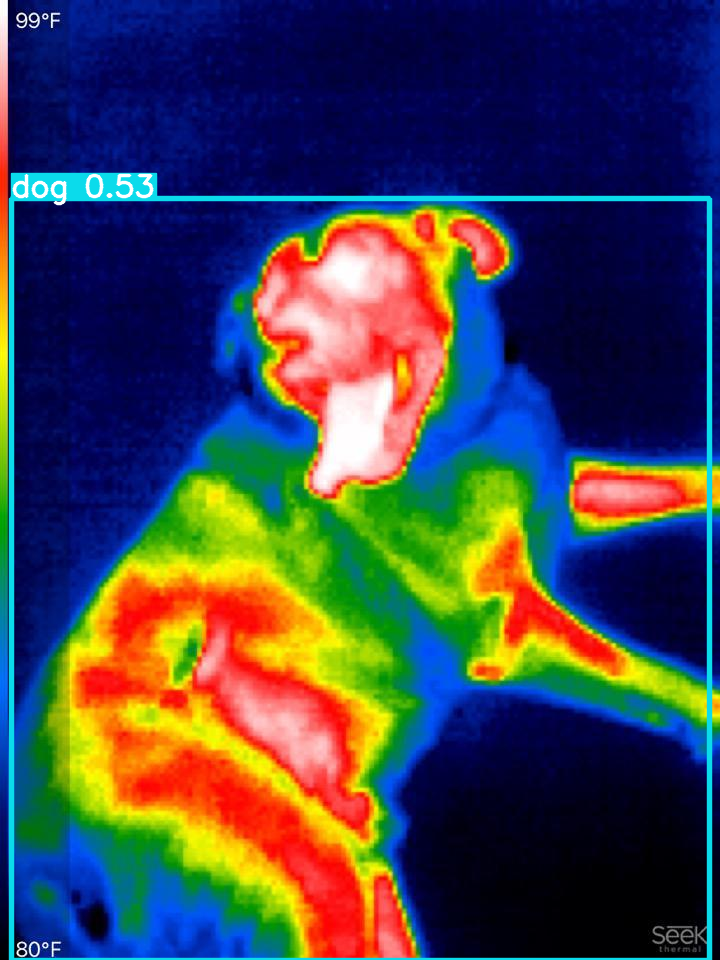

Saved 1 image to runs\detect\exp238


In [30]:
from PIL import Image
import torch
import sys

# loads in our final trained yolo model for thermal images
model = torch.hub.load('ultralytics/yolov5', 'custom', path = 'yolov5/runs/train/exp9/weights/best.pt')

# Directory for testing images
test_images_dir = "yolov5_data/images/test"

# Model is applied to testing images and results are shown
for img_path in os.listdir(test_images_dir):
    if img_path.endswith('.jpg'):
        img = Image.open(os.path.join(test_images_dir, img_path))
        results = model(img)
        results.show()
        results.save(Path("output/"))